# Import modules

In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import numpy as np
import numpy.random as random
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import anndata


import celltypist
from celltypist import models

import sctk
import os

In [2]:
import session_info
session_info.show()

In [10]:
sc.settings.set_figure_params(dpi=120, facecolor='white', color_map = 'RdPu',)

# Function

In [4]:
#>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
# extract rank_genes_groups result 
#>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>

import scanpy as sc
import pandas as pd

def rank_genes_groups_to_df(adata, cell):
    
    dic = adata.uns['rank_genes_groups'] 
    
    df = pd.DataFrame({
        'names' : dic['names'][cell],
        'scores' : dic['scores'][cell],
        'pvals' : dic['pvals'][cell],
        'pvals_adj' : dic['pvals_adj'][cell],
        'logfoldchanges' : dic['logfoldchanges'][cell]
    })
    
    return df

# Read in data

In [5]:
compartment = 'Myeloid'

In [7]:
adata = sc.read_h5ad(f'/home/jovyan/mount/gdrive/Colab/data/scVI/subsets/RNA_foetal_{compartment}_post-scVI_16Feb2023.h5ad')
adata

AnnData object with n_obs × n_vars = 18527 × 28267
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', '_scvi_labels', '2Jan_coarse_grain', '2Jan_mid_grain', '2Jan_fine_grain', 'leiden_scVI', 'FACSgate', 'sex', 'week', 'trimester', 'cell_type2'
    var: 'gene_name_scRNA-0', 'gene_id', 'n_cells'
    uns: '_scvi_manager_uuid', '_scvi_

# Log-normalise

In [8]:
# normalise and logtransform
# adata.raw = adata
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

# Clustering, UMAP

### Deciding resolution

In [ ]:
%%time

sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.umap(adata, min_dist=0.2, spread=1.0, n_components=3)

resolutions = [0.2,0.3,0.4,0.5,0.6,] # 0.7,0.8,0.9,1.0
for res in resolutions:
    print(res)
    sc.tl.leiden(adata, resolution=res, key_added=f'leiden_scVI_{res}')
    sc.pl.umap(adata, color=[f'leiden_scVI_{res}'], size=5, components='all', wspace=0.5)

In [55]:
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.umap(adata, min_dist=0.2, spread=1.0, n_components=3)
sc.tl.leiden(adata, resolution=1, key_added='leiden_scVI')

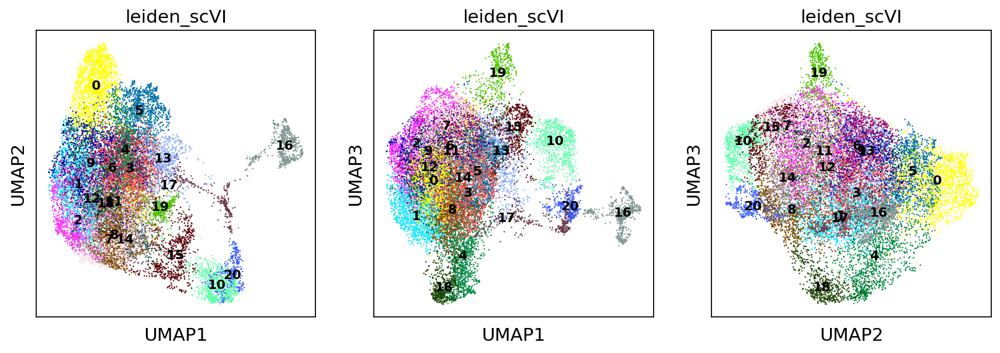

In [56]:
sc.pl.umap(adata, color=['leiden_scVI'], size=5, wspace=0.1, legend_loc='on data', legend_fontsize=10,components='all')

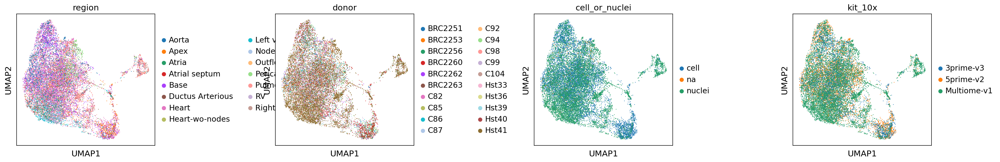

In [29]:
sc.pl.umap(adata, color=['region','donor','cell_or_nuclei','kit_10x'], size=5, wspace=0.7)

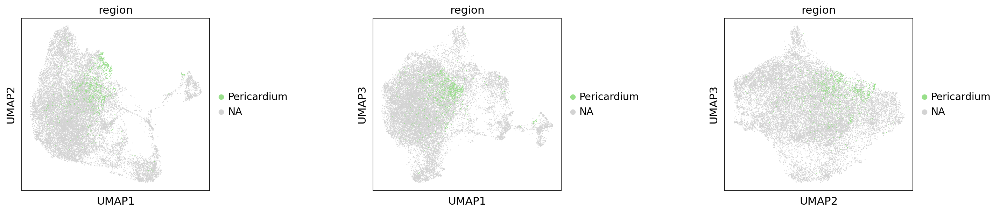

In [46]:
sc.pl.umap(adata, color=['region'],groups='Pericardium', size=5, wspace=0.7,components='all')

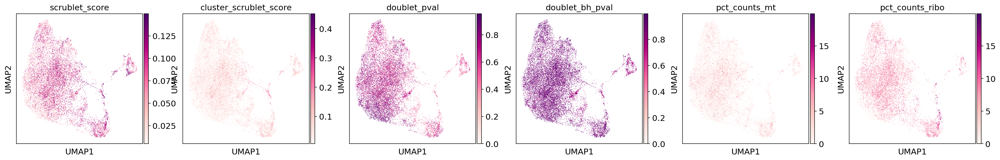

In [30]:
sc.pl.umap(adata, color=['scrublet_score','cluster_scrublet_score','doublet_pval','doublet_bh_pval','pct_counts_mt','pct_counts_ribo'], size=2, wspace=0.2, ncols=6)

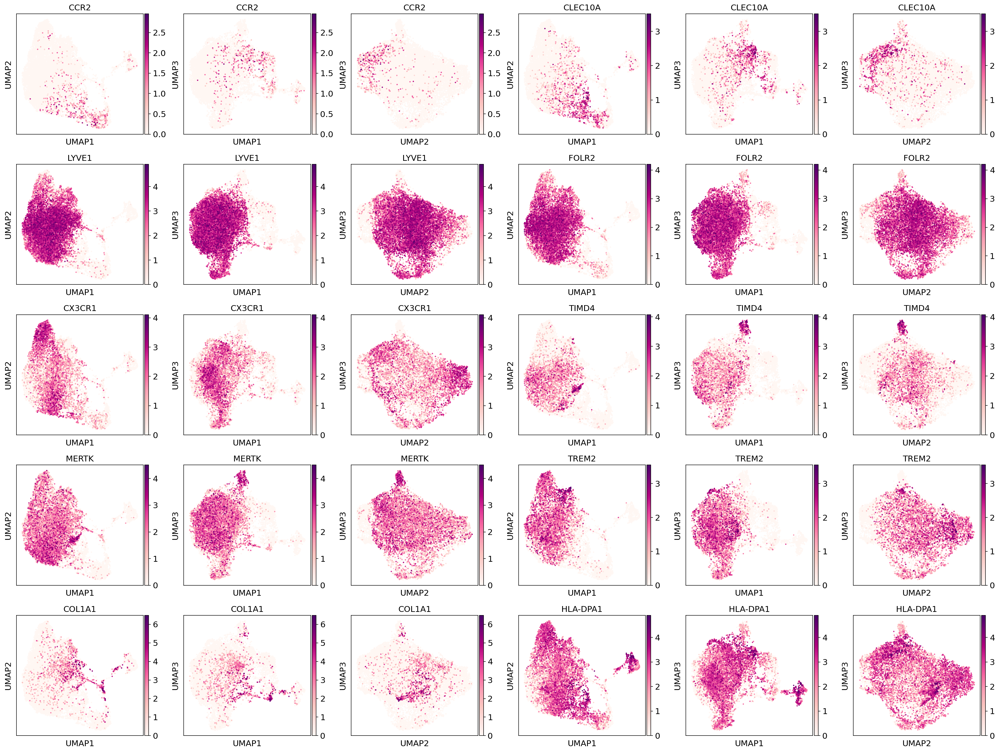

In [17]:
genes=['CCR2','CLEC10A','LYVE1','FOLR2','CX3CR1','TIMD4','MERTK','TREM2','COL1A1','HLA-DPA1']
genes = [x for x in genes if x in adata.var_names]
sc.pl.umap(adata, color=genes, size=20, wspace=0.2, ncols=6, components='all')

# Marker gene expressions

categories: 0, 1, 2, etc.
var_group_labels: vCM, aCM, FB, etc.


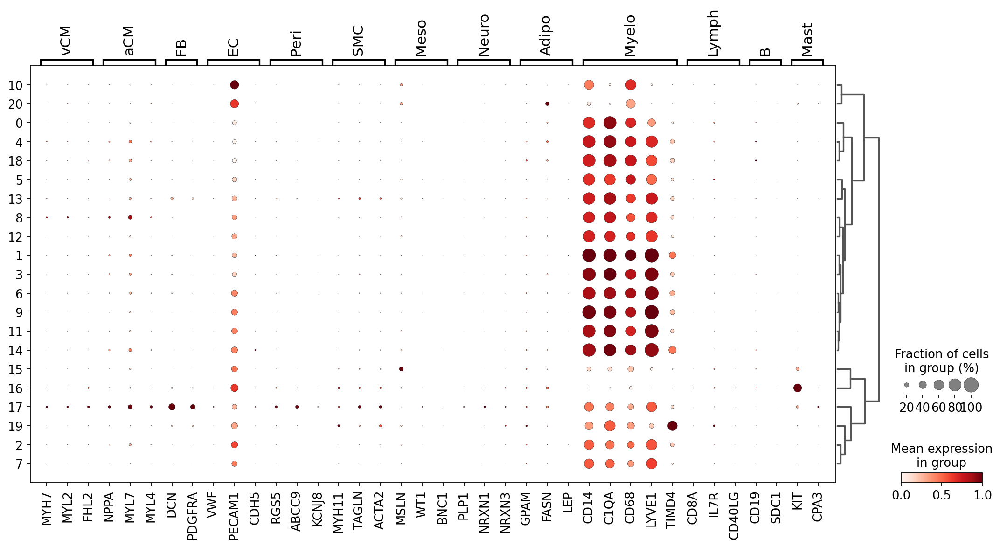

In [31]:
# Checking glabal markers
markers = {
    'vCM': ['MYH7', 'MYL2', 'FHL2'],
    'aCM': ['NPPA', 'MYL7', 'MYL4'],
    'FB': ['DCN', 'GCN', 'PDGFRA'],
    'EC': ['VWF', 'PECAM1', 'CDH5'],
    'Peri': ['RGS5', 'ABCC9', 'KCNJ8'],
    'SMC': ['MYH11', 'TAGLN', 'ACTA2'],
    'Meso': ['MSLN', 'WT1', 'BNC1'],
    'Neuro': ['PLP1', 'NRXN1', 'NRXN3'],
    'Adipo': ['GPAM', 'FASN', 'LEP'],
    'Myelo': ['CD14', 'C1QA', 'CD68','LYVE1','TIMD4'],
    'Lymph': ['CD8A', 'IL7R', 'CD40LG'],
    'B': ['CD19','SDC1','IGHG1','IGHA1'],
    'Mast': ['KIT', 'CPA3'],
}

for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.tl.dendrogram(adata, groupby='leiden_scVI')
sc.pl.dotplot(adata,
              markers, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

categories: 0, 1, 2, etc.
var_group_labels: B cell, T cell, naive, etc.


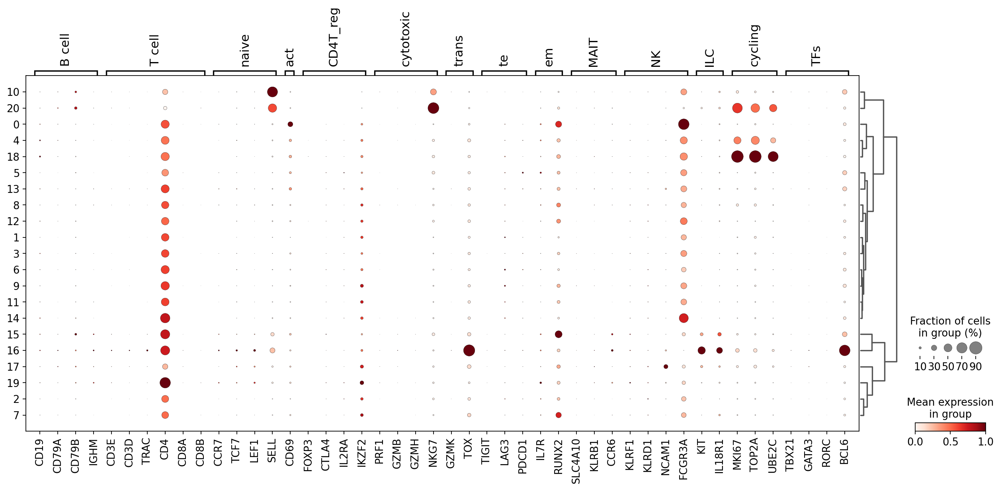

In [32]:
# lymphocytes markers

markers={
    'B cell': ['CD19', 'CD79A', 'CD79B', 'IGHM', 'IGHG1', 'IGHA1'],
    'T cell': ['CD3E', 'CD3D', 'TRAC', 'CD4', 'CD8A', 'CD8B'],
    'naive': ['CCR7', 'TCF7', 'LEF1', 'SELL'],
    'act': ['IL2','CD69'],
    'CD4T_reg': ['FOXP3', 'CTLA4', 'IL2RA', 'IKZF2'],
    'cytotoxic': ['PRF1', 'GZMB', 'GZMH', 'NKG7'],
    'trans': ['GZMK', 'TOX'],
    'te': ['TIGIT', 'LAG3', 'PDCD1'],
    'em': ['IL7R', 'RUNX2'],
    'MAIT': ['SLC4A10', 'KLRB1', 'CCR6'],
    'NK': ['KLRF1', 'KLRD1', 'NCAM1', 'FCGR3A'],
    'ILC': ['KIT', 'IL18R1'],
    'cycling': ['MKI67', 'TOP2A', 'UBE2C'],
    'TFs': ['TBX21', 'GATA3', 'RORC', 'BCL6',],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

categories: 0, 1, 2, etc.
var_group_labels: Mono, MP, PS-R, etc.


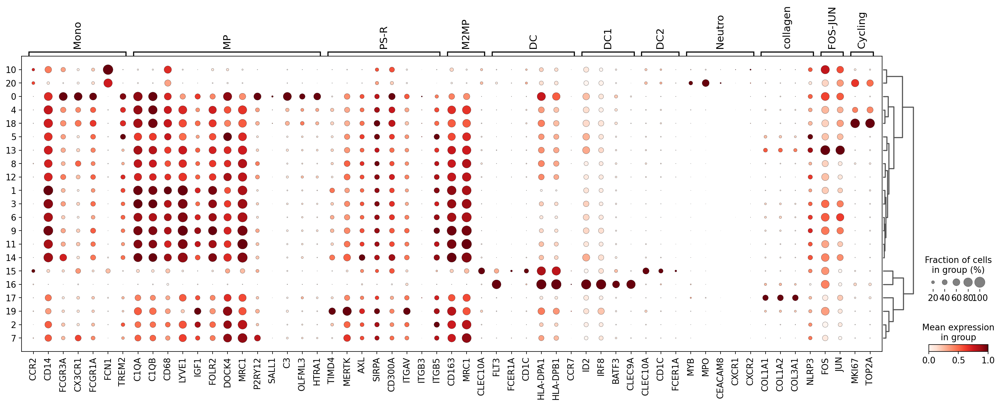

In [40]:
markers={
    'Mono':['CCR2','CD14','FCGR3A','CX3CR1','FCGR1A','FCN1','TREM2'],
    'MP':['C1QA','C1QB','CD68','LYVE1','IGF1','FOLR2','DOCK4','MRC1','P2RY12','SALL1','C3','OLFML3','HTRA1'],
    'PS-R':['TIMD4','MERTK','AXL','SIRPA','CD300A','ITGAV','ITGB3','ITGB5'],
    'M2MP':['CD163','MRC1','CLEC10A'],
    'DC':['FLT3','FCER1A','CD1C','HLA-DPA1','HLA-DPB1','CCR7'],
    'DC1':['ID2','IRF8','BATF3','CLEC9A'],
    'DC2':['CLEC10A','CD1C','FCER1A',],
    'Neutro':['MYB', 'MPO', 'CEACAM8','CXCR1','CXCR2'],
    'collagen':['COL1A1','COL1A2','COL3A1','NLRP3'],
    'FOS-JUN':['FOS','JUN'],
    'Cycling':['MKI67','TOP2A'],

}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

In [ ]:
adata.X.data[:10]

# DEG analysis

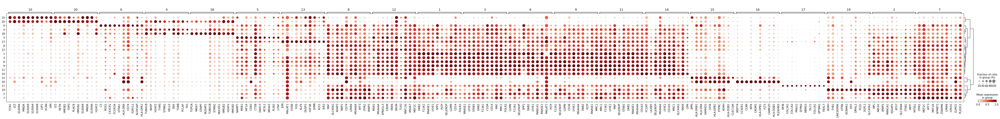

In [34]:
sc.tl.rank_genes_groups(adata, 'leiden_scVI', method='t-test')

DEG_dict = {}
for cluster in adata.obs['leiden_scVI'].cat.categories:
    df=rank_genes_groups_to_df(adata, cluster)
    # select genes: significant and up-regulated ones
    df=df[(df['pvals_adj']<0.05)&(df['logfoldchanges']>0)]
    # sort based on the logFC
    df.sort_values('scores',ascending=False,inplace=True)
    DEG_dict[cluster]=list(df[:10]['names'])
    del df

sc.pl.dotplot(adata,
              DEG_dict, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              swap_axes=False,
             )

# CellTypist prediction

In [36]:
# load model and predict
panfetal_model = models.Model.load('/nfs/team205/kk18/Analysis/celltypist/models/celltypist_model.Pan_Fetal_Human.pkl')
prediction=celltypist.annotate(adata, model = panfetal_model, majority_voting = True)

🔬 Input data has 18527 cells and 28267 genes
🔗 Matching reference genes in the model
🧬 6636 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 10
🗳️ Majority voting the predictions
✅ Majority voting done!


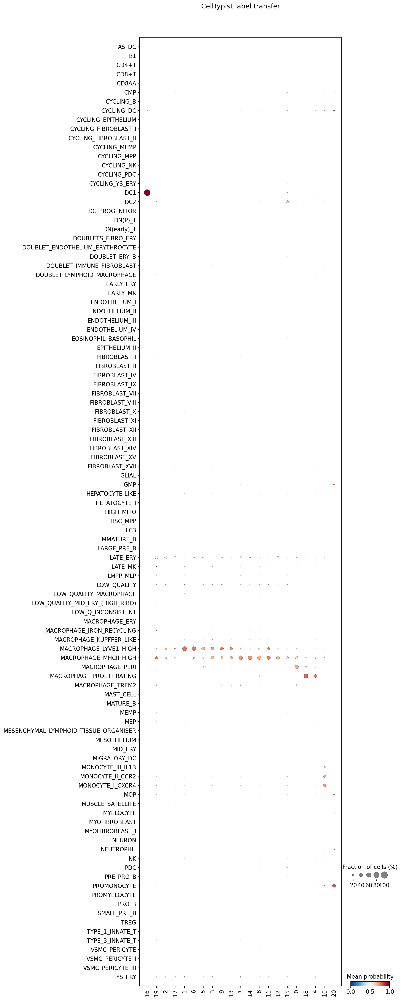

In [37]:
celltypist.dotplot(prediction, use_as_reference = 'leiden_scVI', use_as_prediction = 'predicted_labels')

# Annotation 

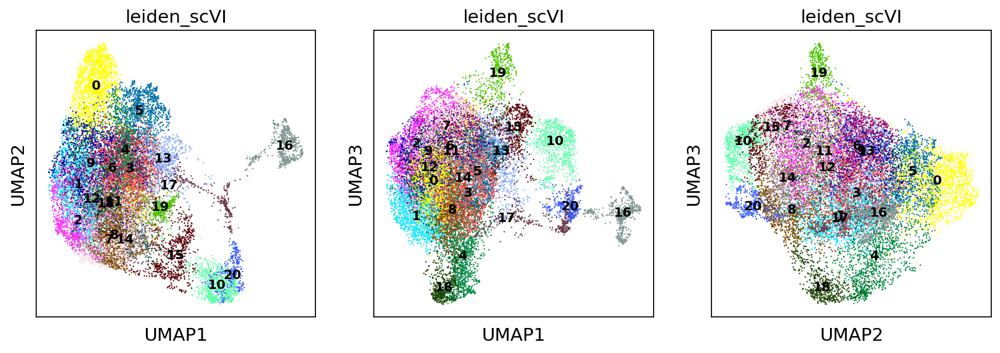

In [38]:
sc.pl.umap(adata, color=['leiden_scVI'], size=5, wspace=0.1, legend_loc='on data', components='all', legend_fontsize=10)

In [42]:
set(adata.obs['2Jan_fine_grain'])

{'B1Cells',
 'BCells',
 'Cardiofibromyocytes',
 'CoronaryCapillaryEndothelialCells',
 'CoronaryPericytes',
 'CoronaryVesselAdventitialFibroblasts',
 'DC1',
 'DC2',
 'DCsMature',
 'DCsPlasmocytoids',
 'EarlyGreatVesselFLRT2',
 'EndocardialCells',
 'GVAdFibOCA2',
 'GVAdFibOther',
 'InnateLymphoidCells',
 'LymphaticEndothelialCells',
 'MacrophagesCX3CR1pos',
 'MacrophagesInflammasome',
 'MacrophagesLYVE1pos',
 'MacrophagesTIMD4pos',
 'MacrophagesTREM2pos',
 'MastCells',
 'Monocytes',
 'MonocytesMPOpos',
 'MyocIntFibROBO2',
 'MyocIntFibSLIT3',
 'Myofibroblasts',
 'NaturalKillerCells',
 'SchwannCells',
 'TCellsCD8pos',
 'Tregs',
 'ValvePENK',
 nan}

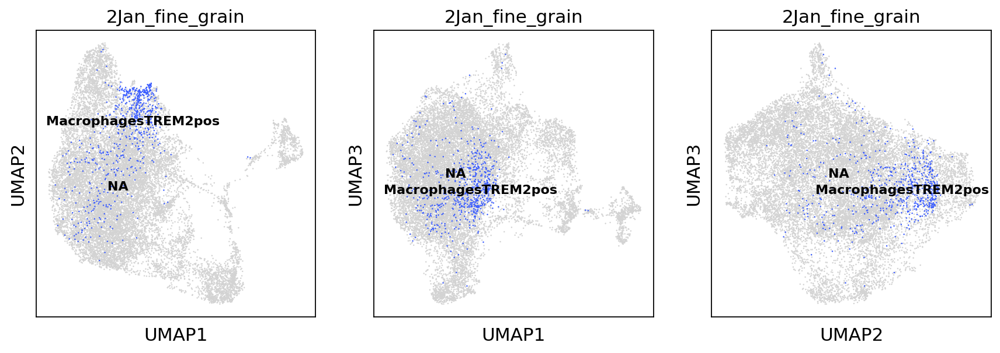

In [44]:
sc.pl.umap(adata, color=['2Jan_fine_grain'], groups='MacrophagesTREM2pos' ,size=5, wspace=0.1, legend_loc='on data', components='all', legend_fontsize=10)

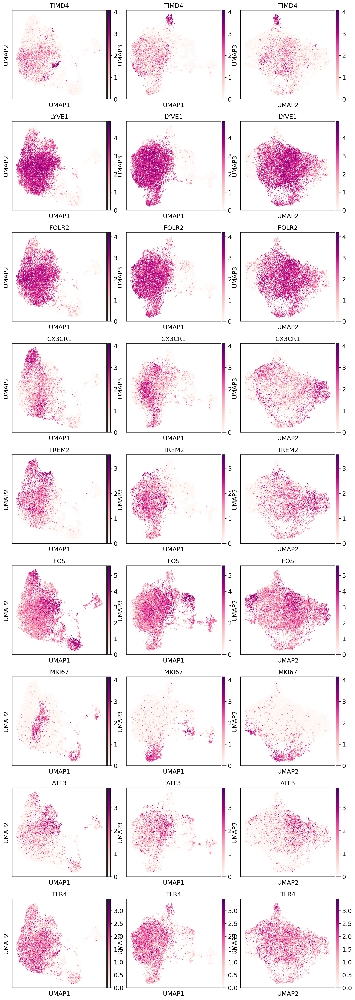

In [76]:
sc.pl.umap(adata, color=['TIMD4','LYVE1','FOLR2','CX3CR1','TREM2','FOS','MKI67','ATF3','TLR4'], size=10, wspace=0.1, 
           legend_loc='on data', components='all', legend_fontsize=10,ncols=3)

In [48]:
pd.crosstab(adata.obs['leiden_scVI'],adata.obs['region'])

region,Aorta,Apex,Atria,Atrial septum,Base,Ductus Arterious,Heart,Heart-wo-nodes,Left ventricle,Nodes,Outflow Tract,Pericardium,Pulmonary arches and branches,RV,Right ventricle + Papillary
leiden_scVI,,,,,,,,,,,,,,,
0,295,20,0,1,453,84,689,2,2,1,1,18,81,1,0
1,220,67,84,8,185,6,608,10,4,8,0,18,32,22,0
2,53,66,24,84,97,20,447,22,199,1,0,9,93,13,29
3,74,113,10,7,176,31,559,1,3,17,2,85,56,1,3
4,48,83,16,11,244,17,576,8,18,5,7,8,36,7,20
5,69,129,3,2,86,22,514,6,12,2,2,230,10,8,5
6,63,77,1,4,114,52,583,1,4,0,0,99,29,0,3
7,12,15,3,18,70,16,365,10,313,3,1,3,36,7,128
8,18,47,110,22,103,3,340,6,32,7,1,1,32,200,17


In [80]:
adata.obs['cell_type3']=adata.obs['leiden_scVI'].astype('str').copy()
adata.obs.replace({'cell_type3':{
    '0':'MP_CX3CR1+', 
    '1':'MP_LYVE1+', 
    '2':'MP_LYVE1+', 
    '3':'MP_LYVE1+', 
    '4':'MP_LYVE1+_cycling', 
    '5':'MP_LYVE1+ATF3+', 
    '6':'MP_LYVE1+', 
    '7':'MP_LYVE1+',   
    '8':'MP_LYVE1+',  
    '9':'MP_LYVE1+', 
    '10':'Mono', 
    '11':'MP_LYVE1+', 
    '12':'MP_LYVE1+', 
    '13':'MP_LYVE1+ATF3+', 
    '14':'MP_LYVE1+', 
    '15':'Mono-derived', 
    '16':'DC1', 
    '17':'Doublet',   
    '18':'MP_LYVE1+_cycling', 
    '19':'MP_TIMD4+',
    '20':'Mono_MPO+', 
}}, inplace=True)


adata.obs['cell_type3']=adata.obs['cell_type3'].astype('category')
adata.obs['cell_type3'].cat.reorder_categories([
    'Mono', 
    'Mono_MPO+', 
    'Mono-derived', 
    'MP_CX3CR1+',
    # 'MP_TREM2+', 
    'MP_TIMD4+', 
    'MP_LYVE1+',
    # 'MP_LYVE1+MHCIIhi', 
    'MP_LYVE1+ATF3+',
    'MP_LYVE1+_cycling',
    'DC1',
    'Doublet',  
], inplace=True)

adata.obs['cell_type3'].value_counts()

MP_LYVE1+            9748
MP_LYVE1+ATF3+       1844
MP_LYVE1+_cycling    1650
MP_CX3CR1+           1648
Mono                  900
Mono-derived          661
DC1                   609
Doublet               583
MP_TIMD4+             470
Mono_MPO+             414
Name: cell_type3, dtype: int64

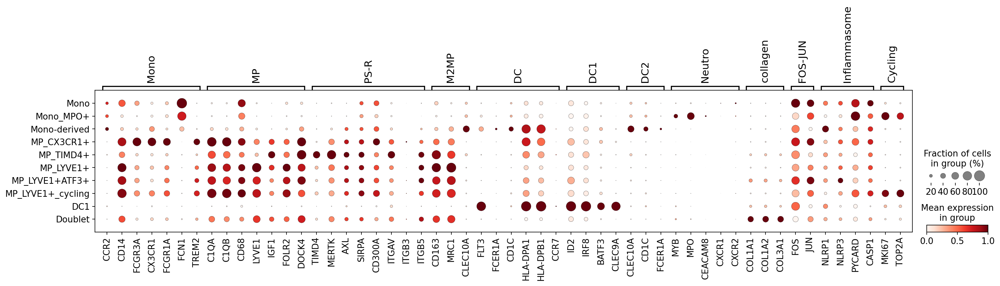

In [81]:
markers={
  'Mono':['CCR2','CD14','FCGR3A','CX3CR1','FCGR1A','FCN1','TREM2'],
    'MP':['C1QA','C1QB','CD68','LYVE1','IGF1','FOLR2','DOCK4'],
    'PS-R':['TIMD4','MERTK','AXL','SIRPA','CD300A','ITGAV','ITGB3','ITGB5'],
    'M2MP':['CD163','MRC1','CLEC10A'],
    'DC':['FLT3','FCER1A','CD1C','HLA-DPA1','HLA-DPB1','CCR7'],
    'DC1':['ID2','IRF8','BATF3','CLEC9A'],
    'DC2':['CLEC10A','CD1C','FCER1A',],
    'Neutro':['MYB', 'MPO', 'CEACAM8','CXCR1','CXCR2'],
    'collagen':['COL1A1','COL1A2','COL3A1'],
    'FOS-JUN':['FOS','JUN'],
    'Inflammasome':['NLRP1','NLRP3','PYCARD','CASP1'],
    'Cycling':['MKI67','TOP2A'],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='cell_type3',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

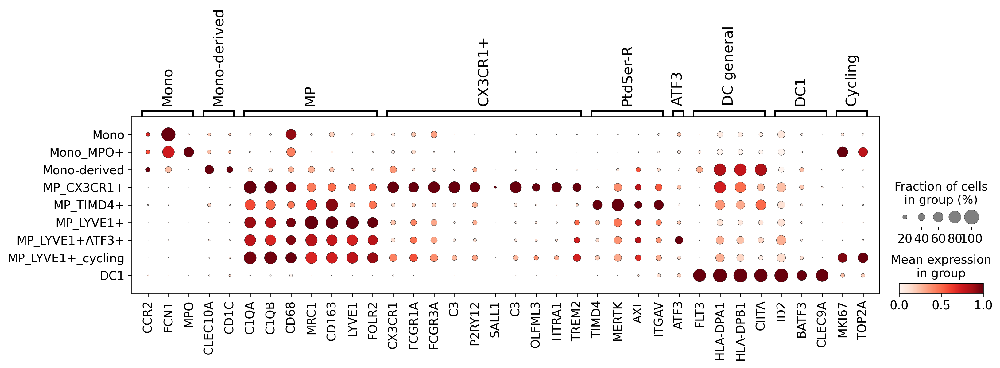

In [116]:
markers={
    'Mono':['CCR2','FCN1','MPO'],
    'Mono-derived':['CLEC10A','CD1C'],
    'MP':['C1QA','C1QB','CD68','MRC1','CD163','LYVE1','FOLR2'],
    'CX3CR1+':['CX3CR1','FCGR1A','FCGR3A','C3','P2RY12','SALL1','C3','OLFML3','HTRA1','TREM2',],
    'PtdSer-R':['TIMD4','MERTK','AXL','ITGAV'],
    'ATF3':['ATF3'],
    'ATF3':['ATF3'],
    'DC general':['FLT3','HLA-DPA1','HLA-DPB1','CIITA'],
    'DC1':['ID2','BATF3','CLEC9A'],
    'Cycling':['MKI67','TOP2A'],
}

for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata[adata.obs['cell_type3']!='Doublet'],
              markers, 
              groupby='cell_type3',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

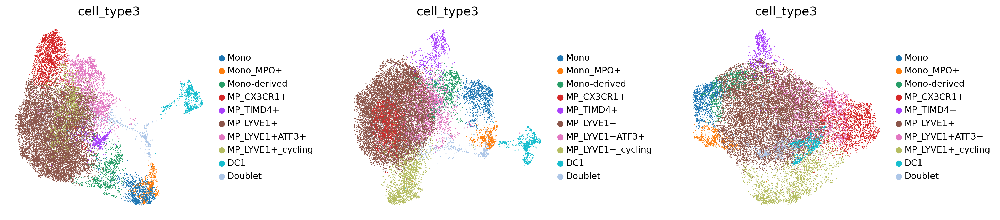

In [84]:
sc.settings.set_figure_params(dpi=120,  color_map = 'RdPu',)
sc.pl.umap(adata, color=['cell_type3'], size=5, legend_fontsize=10, frameon=False, components='all', wspace=0.5)

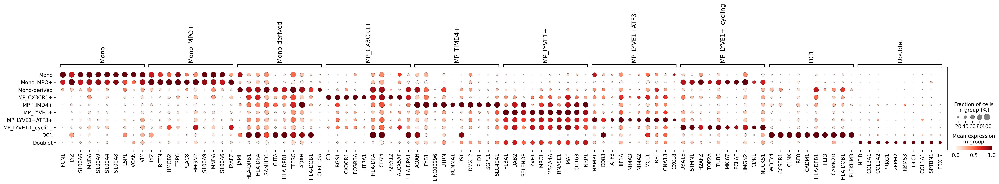

In [85]:
sc.tl.rank_genes_groups(adata, 'cell_type3', method='t-test')

DEG_dict = {}
for cluster in adata.obs['cell_type3'].cat.categories:
    df=rank_genes_groups_to_df(adata, cluster)
    # select genes: significant and up-regulated ones
    df=df[(df['pvals_adj']<0.05)&(df['logfoldchanges']>0)]
    # sort based on the logFC
    df.sort_values('scores',ascending=False,inplace=True)
    DEG_dict[cluster]=list(df[:10]['names'])
    del df

sc.pl.dotplot(adata,
              DEG_dict, 
              groupby='cell_type3',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              swap_axes=False,
             )

# Recover row counts and save

In [86]:
adata_raw=sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/Immune/RNA_foetal_raw_immune_16Feb2023.h5ad')
print(adata_raw.shape)

adata_raw=anndata.AnnData(X=adata_raw[adata.obs_names,:].X,
                      obs=adata.obs, # from annotated or subsetted data
                      var=adata_raw.var,
                      obsm=adata.obsm, # from annotated or subsetted data
                      obsp=adata.obsp # from annotated or subsetted data
                               )
print(adata_raw.shape)

(41881, 36601)
(18527, 36601)


In [87]:
adata_raw.write('/nfs/team205/heart/anndata_objects/Foetal/Immune/RNA_foetal_raw_Myeloid_16Feb2023.h5ad')
adata_raw

AnnData object with n_obs × n_vars = 18527 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', '_scvi_labels', '2Jan_coarse_grain', '2Jan_mid_grain', '2Jan_fine_grain', 'leiden_scVI', 'FACSgate', 'sex', 'week', 'trimester', 'cell_type2', 'cell_type3'
    var: 'gene_name_scRNA-0', 'gene_id'
    obsm: 'X_pca', 'X_scVI', 'X_uma

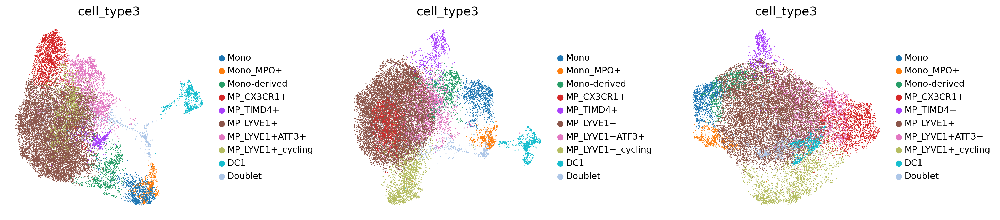

In [88]:
sc.pl.umap(adata_raw, color=['cell_type3'], size=5, legend_fontsize=10, frameon=False, components='all', wspace=0.5)

In [5]:
adata_raw = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/Immune/RNA_foetal_raw_Myeloid_16Feb2023.h5ad')
adata_raw

AnnData object with n_obs × n_vars = 18527 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', '_scvi_labels', '2Jan_coarse_grain', '2Jan_mid_grain', '2Jan_fine_grain', 'leiden_scVI', 'FACSgate', 'sex', 'week', 'trimester', 'cell_type2', 'cell_type3'
    var: 'gene_name_scRNA-0', 'gene_id'
    obsm: 'X_pca', 'X_scVI', 'X_uma

In [90]:
# save metadata
adata_raw.obs.to_csv('/nfs/team205/heart/anndata_objects/Foetal/Immune/RNA_foetal_raw_Myeloid_16Feb2023.obs.csv')

In [6]:
adata = adata_raw.copy()
# normalise and logtransform
# adata.raw = adata
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

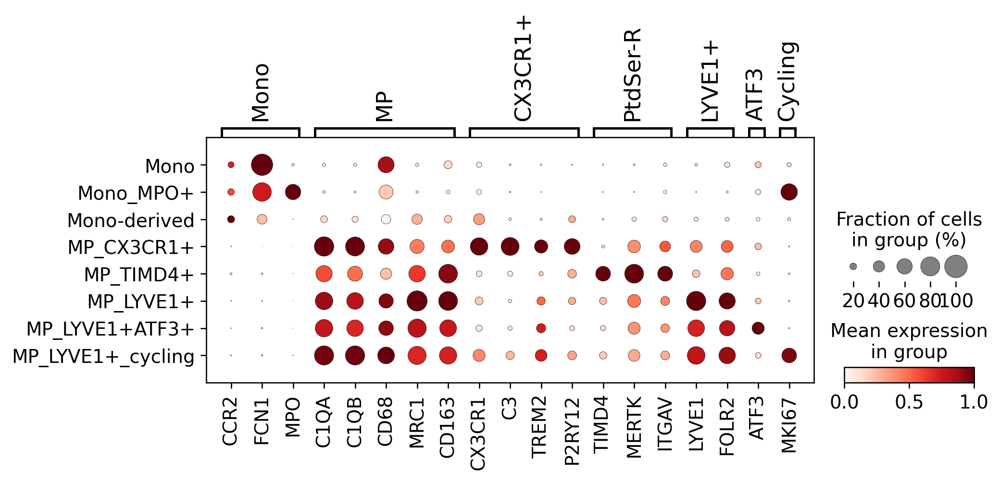

In [23]:
markers={
    'Mono':['CCR2','FCN1','MPO'],
    # 'Mono-derived':['CLEC10A','CD1C'],
    'MP':['C1QA','C1QB','CD68','MRC1','CD163'],
    'CX3CR1+':['CX3CR1','C3','TREM2','OLFMl3','P2RY12'],
    'PtdSer-R':['TIMD4','MERTK','ITGAV'],
    'LYVE1+':['LYVE1','FOLR2'],
    'ATF3':['ATF3'],
    'Cycling':['MKI67'],
}

for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata[adata.obs['cell_type3'].isin(['Doublet','DC1'])==False],
              markers, 
              groupby='cell_type3',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

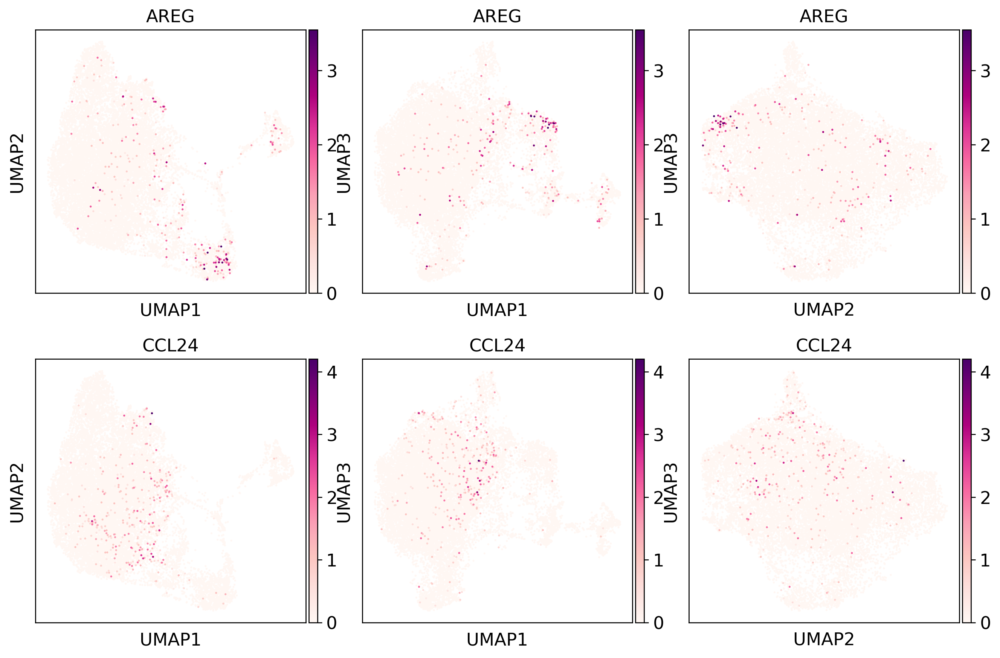

In [11]:
sc.pl.umap(adata, 
           color=['AREG','CCL24'], size=10, wspace=0.1, 
           legend_loc='on data', components='all', legend_fontsize=10,ncols=3)

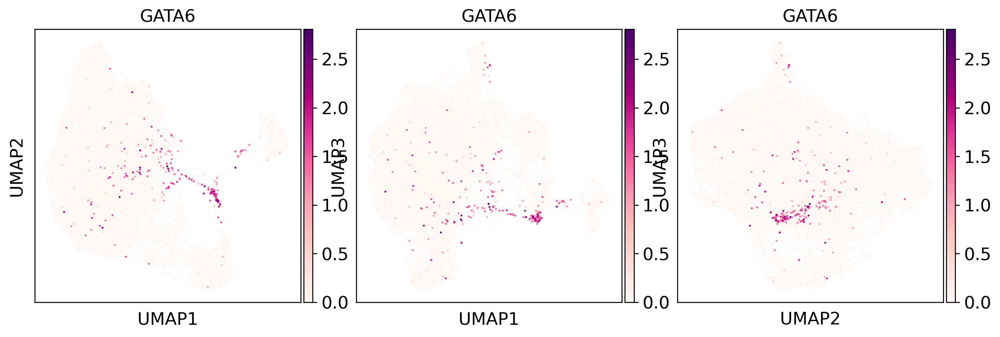

In [10]:
sc.pl.umap(adata, 
           color=['GATA6'], size=10, wspace=0.1, 
           legend_loc='on data', components='all', legend_fontsize=10,ncols=3)

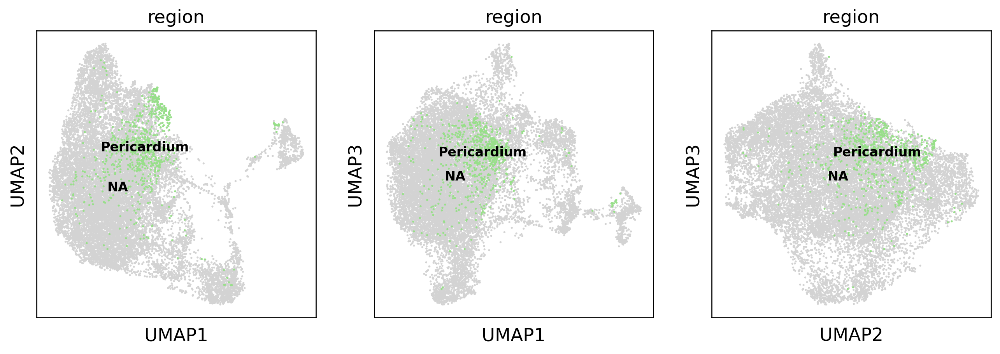

In [11]:
sc.pl.umap(adata, 
           color=['region'], groups='Pericardium', size=10, wspace=0.1, 
           legend_loc='on data', components='all', legend_fontsize=10,ncols=3)

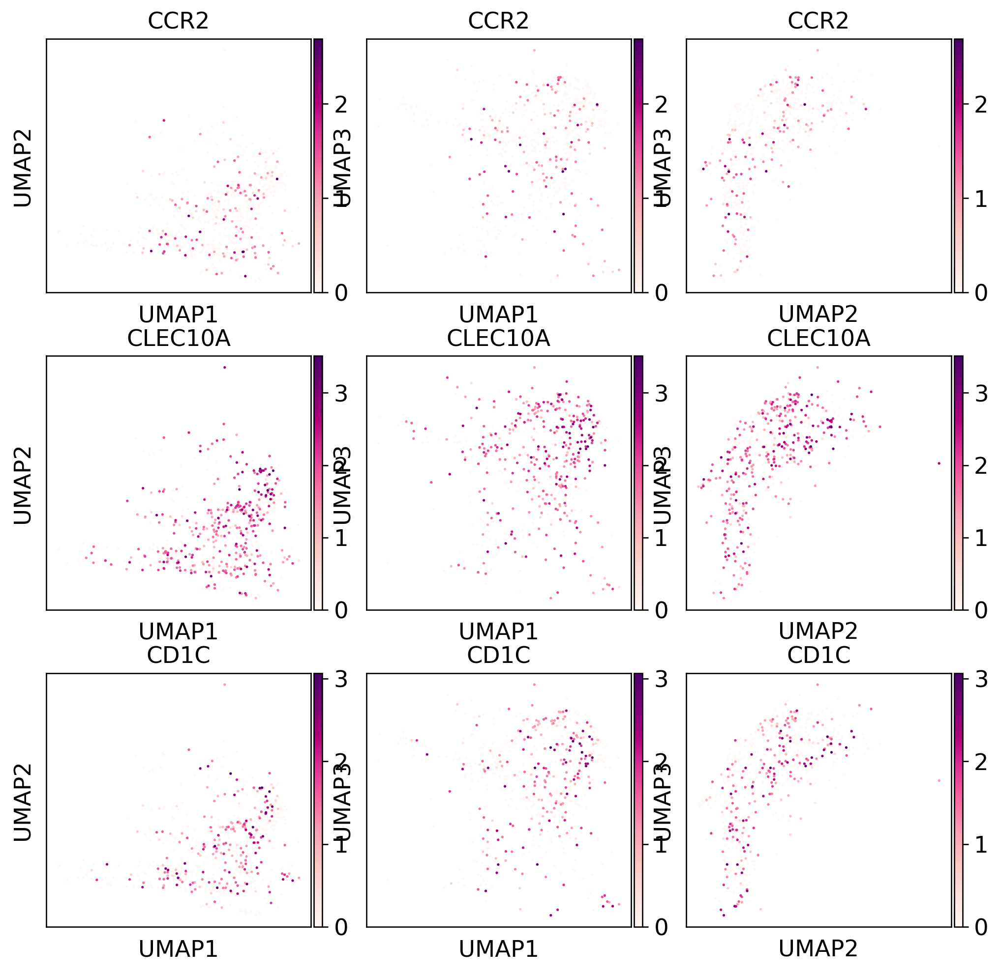

In [110]:
sc.pl.umap(adata[adata.obs['cell_type3']=='Mono-derived'], 
           color=['CCR2','CLEC10A','CD1C'], size=10, wspace=0.1, 
           legend_loc='on data', components='all', legend_fontsize=10,ncols=3)

# Celltypist, pan-foetal immune

🔬 Input data has 18527 cells and 28267 genes
🔗 Matching reference genes in the model
🧬 6636 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!


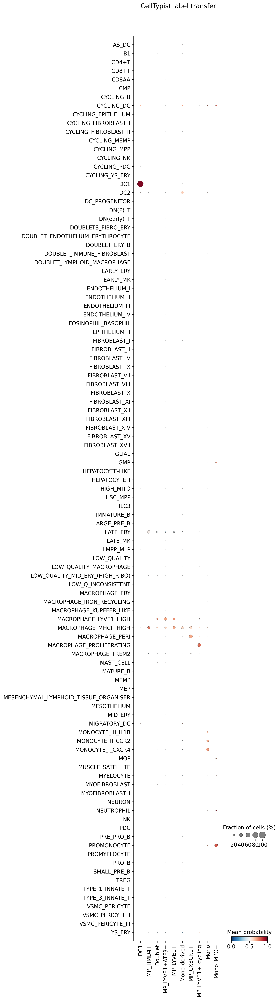

In [89]:
# load model and predict
panfetal_model = models.Model.load('/nfs/team205/kk18/Analysis/celltypist/models/celltypist_model.Pan_Fetal_Human.pkl')
prediction=celltypist.annotate(adata, model = panfetal_model, majority_voting = False)
celltypist.dotplot(prediction, use_as_reference = 'cell_type3', use_as_prediction = 'predicted_labels')

# CellTypist prediction: EL-YS

🔬 Input data has 18527 cells and 28267 genes
🔗 Matching reference genes in the model
🧬 16762 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!


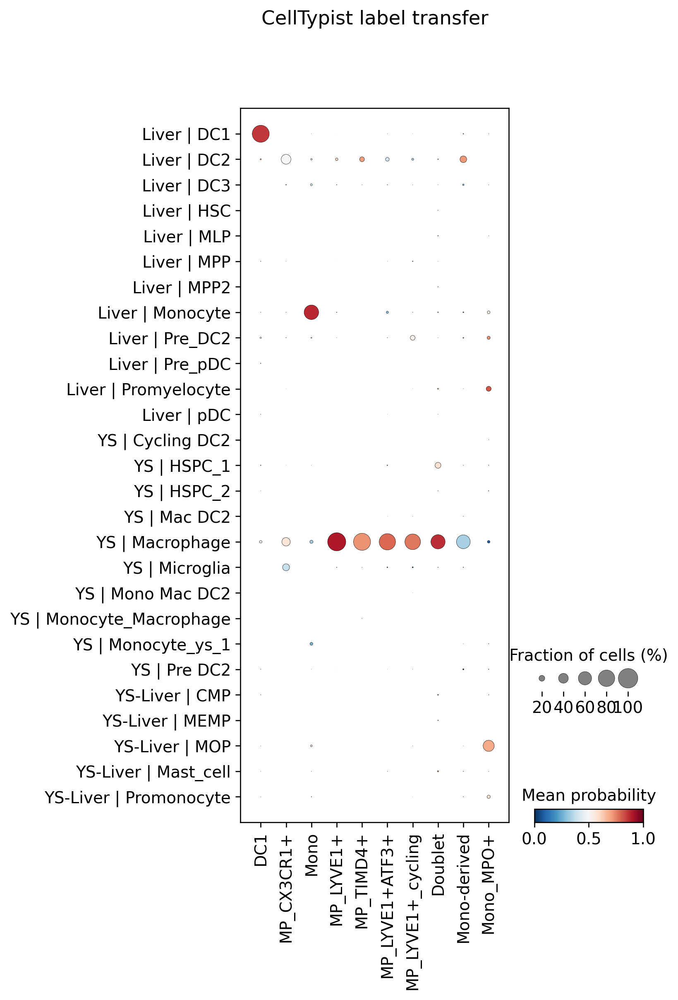

In [91]:
# load model
elys_model = models.Model.load('/nfs/team205/heart/anndata_objects/Haniffa_YolkSac/celltypist_EL-YS_myeloid.pkl')
prediction=celltypist.annotate(adata, model = elys_model, majority_voting = False)
celltypist.dotplot(prediction, use_as_reference = 'cell_type3', use_as_prediction = 'predicted_labels')

In [92]:
adata = prediction.to_adata(insert_labels = True, insert_conf = True)

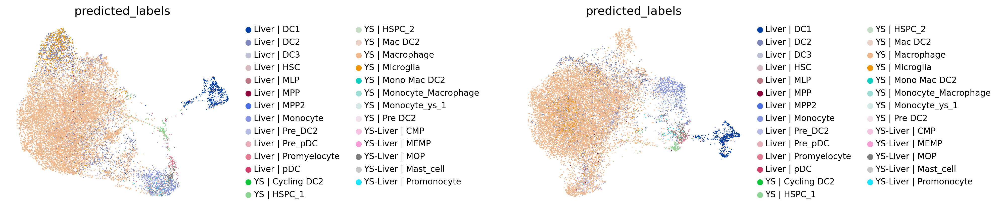

In [93]:
sc.pl.umap(adata, color=['predicted_labels'], size=5, legend_fontsize=10, frameon=False, wspace=1,components=['1,2','1,3'])

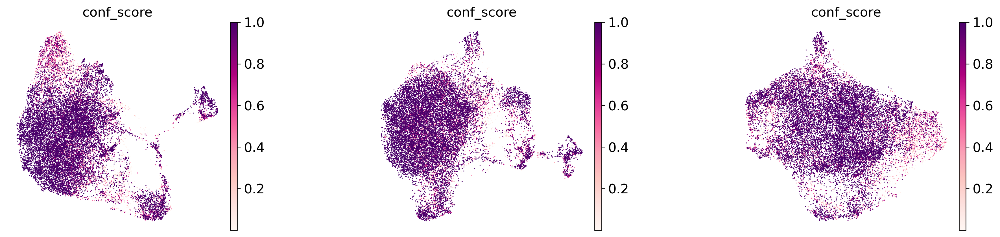

In [94]:
sc.pl.umap(adata, color=['conf_score'], size=5, legend_fontsize=10, frameon=False, wspace=0.5, components='all')

# Check matching with previoius annotation

In [95]:
pd.crosstab(adata.obs['cell_type3'],adata.obs['2Jan_fine_grain']).T

cell_type3,Mono,Mono_MPO+,Mono-derived,MP_CX3CR1+,MP_TIMD4+,MP_LYVE1+,MP_LYVE1+ATF3+,MP_LYVE1+_cycling,DC1,Doublet
2Jan_fine_grain,,,,,,,,,,
B1Cells,2,0,2,0,3,19,2,0,3,6
BCells,0,1,0,0,0,0,0,0,1,0
Cardiofibromyocytes,0,0,0,0,0,1,1,0,0,4
CoronaryCapillaryEndothelialCells,0,0,0,0,0,0,0,0,0,1
CoronaryPericytes,0,0,0,0,0,0,0,0,0,1
CoronaryVesselAdventitialFibroblasts,0,0,0,0,0,0,0,0,0,5
DC1,0,1,2,0,0,2,3,1,536,1
DC2,41,2,492,16,29,284,35,8,17,2
DCsMature,0,0,1,0,0,0,0,0,1,0


<AxesSubplot:xlabel='2Jan_fine_grain', ylabel='cell_type3'>

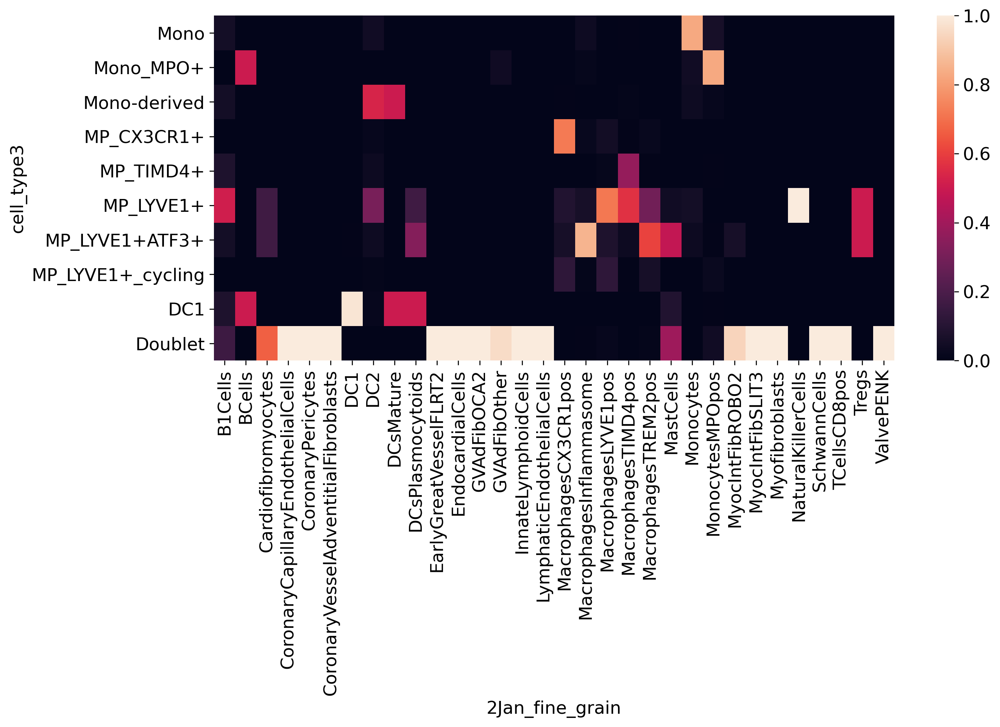

In [96]:
import seaborn as sns
plt.rcParams['figure.figsize'] = 12,5
df=pd.crosstab(adata.obs['cell_type3'],adata.obs['2Jan_fine_grain'],normalize='columns')
sns.heatmap(df)

<AxesSubplot:xlabel='2Jan_fine_grain', ylabel='cell_type3'>

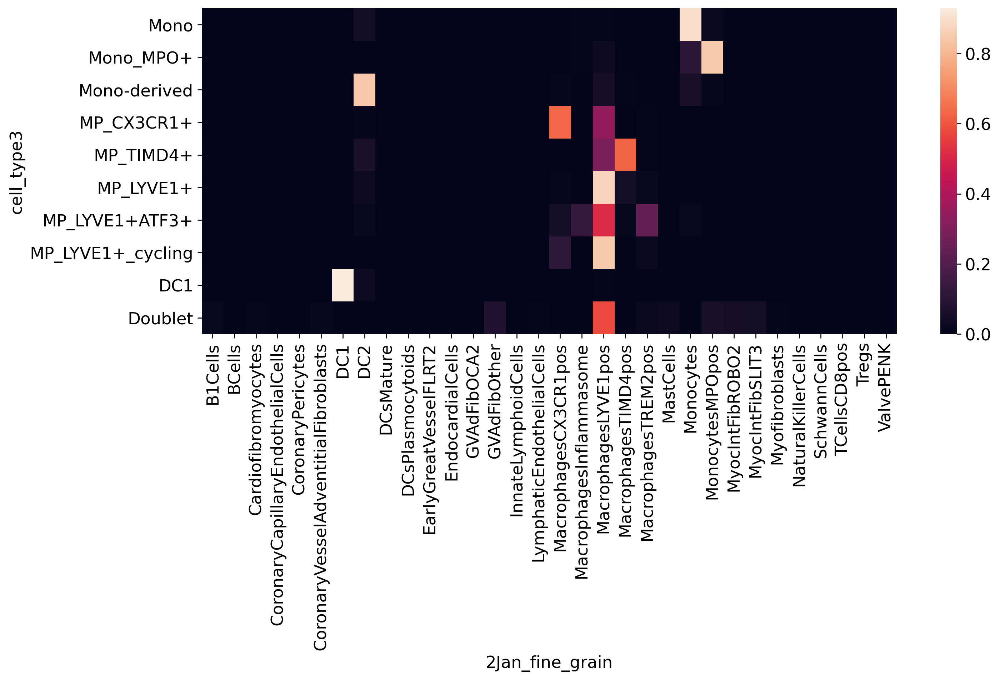

In [98]:
import seaborn as sns
plt.rcParams['figure.figsize'] = 13,5
ad=adata[adata.obs['2Jan_fine_grain']!='nan']
df=pd.crosstab(ad.obs['cell_type3'],ad.obs['2Jan_fine_grain'],normalize='index')
sns.heatmap(df)